In [ ]:
#################################################################################
# Author: Paulina Arregocés Guerra
# Research groups 
# GITA (Applied Telecommunications Research Group)  - Universidad de Antioquia 
# GIDIA (Artificial Intelligence Research Group) - Universidad Nacional de Colombia
#
# Last modified on 08/06/2023 
# Desciotion: This code is used to label the dataset and to train and test the decision # tree and support vector machine models with real data. 
#################################################################################

# Tunning weights for BNN's

## Libraries

In [ ]:
# Select your preferences and run the install command...https://pytorch.org/
#!pip3 install torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cpu

# Uncomment for requirement libraries versions
#!pip install -r requirements.txt 

In [1]:
import os 
import pandas as pd
import numpy as np
import torch
import torchvision
import torch.optim as optim
import torch.nn as nn 
from torch.utils.data import Dataset 
import torch.nn.functional as F
from torch.autograd import Variable
from torch.utils.data.sampler import WeightedRandomSampler

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import MaxAbsScaler, StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils.multiclass import unique_labels
from sklearn.model_selection import GridSearchCV
from random import random
import math 

from sklearn import metrics
from sklearn.metrics import classification_report

import seaborn as sns
import matplotlib.pyplot as plt

print('Libraries fully imported')

Libraries fully imported


## DATA

### Loading saved Data

In [4]:
# Only run to see data from CSV
def load_data(file_input, file_label):
    Input= pd.read_csv(file_input,index_col=False)
    Label= pd.read_csv(file_label,index_col=False)
    return Input, Label
    
# Decoded data  
Dec_data = load_data('.\CSV_TXT\Datos_Trans01.csv','.\CSV_TXT\labels01.csv')
# Binary data
Bin_data = load_data('.\CSV_TXT\Datos_Trans1-1.csv','.\CSV_TXT\labels1-1.csv')

In [5]:
# Only run to see data from CSV
Bin_data_input, Bin_data_label = Bin_data
Bin_data_input['final_vec']

0         [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...
1         [1, 1, 1, 1, 1, 1, 1, 1, 1, -1, 1, -1, 1, 1, 1...
2         [1, 1, 1, 1, 1, 1, 1, 1, -1, 1, 1, 1, -1, 1, 1...
3         [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, -1, 1, -1, ...
4         [1, 1, 1, 1, 1, 1, 1, 1, 1, -1, 1, -1, 1, 1, 1...
                                ...                        
677593    [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, -1, 1, -1, ...
677594    [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, -1, 1, -1, ...
677595    [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, -1, 1, -1, ...
677596    [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, -1, 1, -1, ...
677597    [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, -1, 1, -1, ...
Name: final_vec, Length: 677598, dtype: object

### Set Train, Validation and Test Data

In [19]:
def transform_data(target_train,target_val,target_test,input_train,input_val,input_test):
    #Labels training, validation and test 
    label_train =torch.from_numpy(np.loadtxt(target_train, dtype=int)) 
    label_val =torch.from_numpy(np.loadtxt(target_val, dtype=int)) 
    label_test =torch.from_numpy(np.loadtxt(target_test, dtype=int))

    # Input training, validation and test
    input_train =torch.torch.Tensor(np.loadtxt(input_train, dtype=int)) 
    input_val =torch.torch.Tensor(np.loadtxt(input_val, dtype=int)) 
    input_test =torch.torch.Tensor(np.loadtxt(input_test, dtype=int)) 
    train = torch.utils.data.TensorDataset(input_train, label_train) 
    val = torch.utils.data.TensorDataset(input_val, label_val)
    test = torch.utils.data.TensorDataset(input_test, label_test)
        
    return train, val, test

In [20]:
# Decoded Data
trainNN, valNN ,testNN= transform_data('./CSV_TXT/target_train.txt', './CSV_TXT/target_val.txt', './CSV_TXT/target_test.txt','./CSV_TXT/features_train.txt', './CSV_TXT/features_val.txt', './CSV_TXT/features_test.txt')
# Binary Data
train_Bin,val_Bin ,test_Bin= transform_data('./CSV_TXT/target_train_Bin.txt', './CSV_TXT/target_val_Bin.txt', './CSV_TXT/target_test_Bin.txt', './CSV_TXT/features_train_Bin.txt', './CSV_TXT/features_val_Bin.txt', './CSV_TXT/features_test_Bin.txt')   

### Checking umbalanced data

In [21]:
# Run only to verify balance data 
train_batch = torch.utils.data.DataLoader(trainNN, batch_size=100, shuffle=True)

total = 0
counter_dict = {0:0, 1:0}
class_sample_count = list()


for data in train_batch:
    Xs, ys = data
    for y in ys:
        counter_dict[int(y)] += 1
        total += 1

print(total)

print(counter_dict)

for i in counter_dict:
    class_sample_count.append(counter_dict[i])
    print(f"{i}: {counter_dict[i]/total*100.0}%")

474318
{0: 263823, 1: 210495}
0: 55.62154503940394%
1: 44.37845496059605%


In [22]:
# Run to configurate balance data
class_weights=[1, 1.25]
samples_weight = [0]*total

for data in train_batch:
    Xs, ys = data
    for idx,(y) in enumerate(ys):
        class_weight=class_weights[y]
        samples_weight[idx]= class_weight

sampler = WeightedRandomSampler(samples_weight, len(samples_weight), 
                                replacement=True)

train_loader = torch.utils.data.DataLoader(trainNN, batch_size=10, sampler=sampler)

for dataNN in train_loader:
    print(dataNN)
    break

[tensor([[0., 0., 0.,  ..., 0., 1., 1.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 1., 0., 0.],
        ...,
        [0., 1., 0.,  ..., 1., 1., 1.],
        [1., 1., 1.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]]), tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 1], dtype=torch.int32)]


In [23]:
# Run to verify balance data 

total = 0
counter_dict = {0:0, 1:0}
class_sample_count = list()

for data in train_loader:
    Xs, ys = data
    for y in ys:
        counter_dict[int(y)] += 1
        total += 1

print(total)
print(counter_dict)

for i in counter_dict:
    class_sample_count.append(counter_dict[i])
    print(f"{i}: {counter_dict[i]/total*100.0}%")

474318
{0: 230895, 1: 243423}
0: 48.67936700694471%
1: 51.32063299305529%


## Artificial Neural Networks Models

### Architecture models

In [24]:
# Sigmoid 
class NetSigmoid(nn.Module): 
    def __init__(self, input_size, output_size): 
        super(NetSigmoid, self).__init__() 
        self.layer1 = nn.Linear(input_size, 120) 
        self.layer2 = nn.Linear(120, output_size) 

    def forward(self, x): 
        x1 = torch.sigmoid(self.layer1(x)) 
        x2 = torch.sigmoid(self.layer2(x1))
        return x2 

# Instantiate the model 
model_Sigmoid = NetSigmoid(104, 1) 

In [25]:
# Relu
class NetRelu(nn.Module): 
    def __init__(self, input_size, output_size): 
        super(NetRelu, self).__init__() 
        self.layer1 = nn.Linear(input_size, 120) 
        self.layer2 = nn.Linear(120, output_size) 

    def forward(self, x): 
        x1 = F.relu(self.layer1(x)) 
        x2 = self.layer2(x1)
        return x2 

# Instantiate the model 
model_Relu = NetRelu(104, 1) 

In [26]:
# Tanh
class NetTanh(nn.Module): 
    def __init__(self, input_size, output_size): 
        super(NetTanh, self).__init__() 
        self.layer1 = nn.Linear(input_size, 120) 
        self.layer2 = nn.Linear(120, output_size) 

    def forward(self, x): 
        x1 = torch.tanh(self.layer1(x)) 
        x2 = self.layer2(x1)
        return x2 

# Instantiate the model 
model_tanh = NetTanh(104, 1) 

### Optimal models

In [32]:
# Run only to train models 
# Function to train different models with sets of training and validations  

def trainModels(model, name_model, trainset, validationset, batch_size, epochs, sampler,loss):
    name_model=name_model
    loss_fn= loss
    lr = 1e-4
    weight_decay = 1e-5
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
    total = 0 
    iterationstrain = 0 
    iterationsval = 0 

    y_loss = {} # loss history
    y_loss['train']=[]
    y_loss['val']=[]

    y_err = {} # Accuracy 
    y_err['train']=[]
    y_err['val']=[]

    lossestrain = np.array([]) 
    lossesval = np.array([]) 

    x_epoch = []
    fig = plt.figure()
    ax0 = fig.add_subplot(121, title="loss")
    ax1 = fig.add_subplot(122, title="accuracy")
    fig.tight_layout(pad=3)

    def draw_curve(current_epoch):
        x_epoch.append(current_epoch)
        ax0.plot(x_epoch, y_loss['train'], 'bo-', label='train')
        ax0.plot(x_epoch, y_loss['val'], 'ro-', label='val')
        ax1.plot(x_epoch, y_err['train'], 'bo-', label='train')
        ax1.plot(x_epoch, y_err['val'], 'ro-', label='val')
        ax0.set_xlabel('epoch')
        #ax0.set_ylabel('%')
        ax1.set_xlabel('epoch')
        
        if current_epoch == 0:
            ax0.legend()
            ax1.legend()
        fig.savefig(os.path.join('./', 'train.jpg'))

    print('""""""Select Model analitics:{}"""""" '.format(name_model))

    
    batch_size=batch_size
    sets={}
    sets['train']=trainset
    sets['val']=validationset    
    dataloaders  = {x: torch.utils.data.DataLoader(sets[x], batch_size=batch_size,sampler=sampler)
    for x in ['train','val']}

    dataset_sizes = {x: len(sets[x]) for x in ['train', 'val']}
    model=model
    
    
    for epoch in range(epochs): # 10 full passes over the data

        for phase in ['train','val']:
            if phase == 'train':
                model.train(True) #train mode
            else: model.train(False) #evaluate mode
        
            running_loss = 0.0
            running_corrects = 0.0

            count = 0
            # Iterate over data.
            for data in dataloaders[phase]:
                if count > 15:
                    break

                count = count + 1
                # get a batch of inputs
                inputs, labels = data
                now_batch_size, c = inputs.shape
                if now_batch_size < batch_size:  # skip the last batch
                    continue

                # zero the parameter gradients
                optimizer.zero_grad()

                # -------- forward --------
                outputs = model(inputs.view(-1,104).float())
                _, preds = torch.max(outputs.data, 1)
                loss = loss_fn(outputs[0:batch_size].view(-1), labels.float())

                del inputs

                # -------- backward + optimize --------
                # only if in training phase
                if phase == 'train':
                    loss.backward()
                    optimizer.step()

                # statistics
                running_loss += loss.item() * now_batch_size
                del loss
                running_corrects += float(torch.sum(preds == labels.data))

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects / dataset_sizes[phase]
            print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase, epoch_loss, epoch_acc))

            y_loss[phase].append(epoch_loss)
            y_err[phase].append(1.0 - epoch_acc)

            # deep copy the model
            if phase == 'val':
                draw_curve(epoch)

### Training New Models

In [28]:
# optimization model 
loss_L1 = nn.L1Loss()
loss_MSE= nn.MSELoss()
loss_BCE= nn.BCELoss()

""""""Select Model analitics:Sigmoid"""""" 
train Loss: 0.0008 Acc: 0.0017
val Loss: 0.0037 Acc: 0.0072
train Loss: 0.0008 Acc: 0.0015
val Loss: 0.0037 Acc: 0.0073
train Loss: 0.0008 Acc: 0.0016
val Loss: 0.0036 Acc: 0.0073
train Loss: 0.0008 Acc: 0.0016
val Loss: 0.0036 Acc: 0.0076
train Loss: 0.0008 Acc: 0.0017
val Loss: 0.0035 Acc: 0.0074
train Loss: 0.0007 Acc: 0.0017
val Loss: 0.0034 Acc: 0.0075
train Loss: 0.0007 Acc: 0.0017
val Loss: 0.0034 Acc: 0.0074
train Loss: 0.0007 Acc: 0.0017
val Loss: 0.0033 Acc: 0.0076
train Loss: 0.0007 Acc: 0.0017
val Loss: 0.0032 Acc: 0.0074
train Loss: 0.0007 Acc: 0.0016
val Loss: 0.0032 Acc: 0.0076


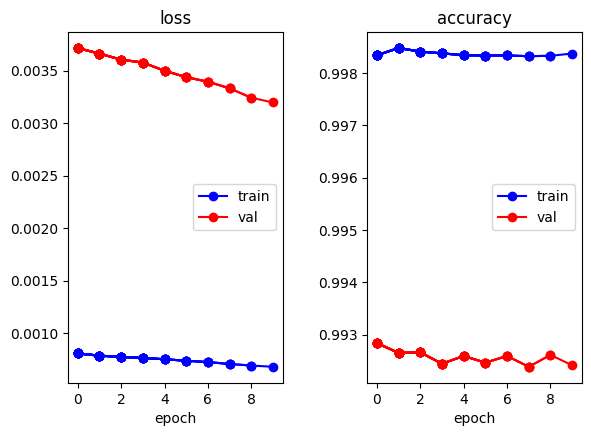

In [33]:
# Train with Sigmoid function activation, batch size =100 epoch=10 and loss function= MSE 
trainModels(model= model_Sigmoid,name_model='Sigmoid',trainset=trainNN, validationset=valNN, batch_size=100,epochs=10, sampler=sampler, loss=loss_MSE)  

""""""Select Model analitics:Sigmoid"""""" 
train Loss: 0.0020 Acc: 0.0016
val Loss: 0.0080 Acc: 0.0076
train Loss: 0.0016 Acc: 0.0016
val Loss: 0.0071 Acc: 0.0080
train Loss: 0.0015 Acc: 0.0016
val Loss: 0.0066 Acc: 0.0079
train Loss: 0.0014 Acc: 0.0016
val Loss: 0.0064 Acc: 0.0070
train Loss: 0.0012 Acc: 0.0016
val Loss: 0.0055 Acc: 0.0077
train Loss: 0.0010 Acc: 0.0016
val Loss: 0.0048 Acc: 0.0075
train Loss: 0.0008 Acc: 0.0016
val Loss: 0.0039 Acc: 0.0073
train Loss: 0.0007 Acc: 0.0017
val Loss: 0.0033 Acc: 0.0075
train Loss: 0.0006 Acc: 0.0016
val Loss: 0.0030 Acc: 0.0073
train Loss: 0.0005 Acc: 0.0016
val Loss: 0.0032 Acc: 0.0077


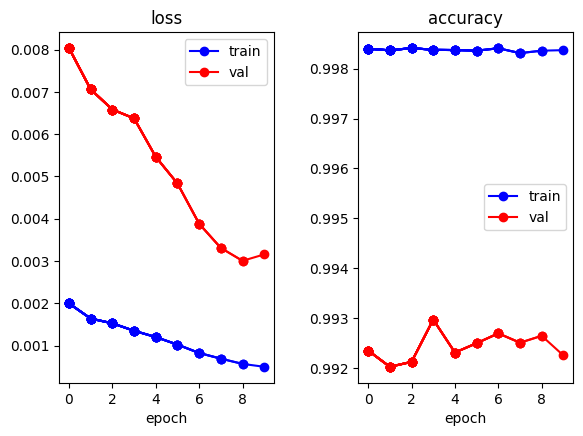

In [34]:
# Train with ReLU function activation, batch size =100 epoch=10 and loss function= L1 
trainModels(model= model_Relu,name_model='Sigmoid',trainset=trainNN, validationset=valNN, batch_size=100,epochs=10, sampler=sampler, loss=loss_L1)  # valores optimos de batch_size y epochs

""""""Select Model analitics:Tanh"""""" 
train Loss: 0.0011 Acc: 0.0017
val Loss: 0.0042 Acc: 0.0078
train Loss: 0.0007 Acc: 0.0017
val Loss: 0.0033 Acc: 0.0075
train Loss: 0.0006 Acc: 0.0017
val Loss: 0.0028 Acc: 0.0077
train Loss: 0.0005 Acc: 0.0017
val Loss: 0.0025 Acc: 0.0078
train Loss: 0.0004 Acc: 0.0017
val Loss: 0.0024 Acc: 0.0072
train Loss: 0.0004 Acc: 0.0017
val Loss: 0.0022 Acc: 0.0076
train Loss: 0.0003 Acc: 0.0017
val Loss: 0.0019 Acc: 0.0077
train Loss: 0.0003 Acc: 0.0017
val Loss: 0.0017 Acc: 0.0083
train Loss: 0.0002 Acc: 0.0017
val Loss: 0.0016 Acc: 0.0080
train Loss: 0.0002 Acc: 0.0016
val Loss: 0.0016 Acc: 0.0074


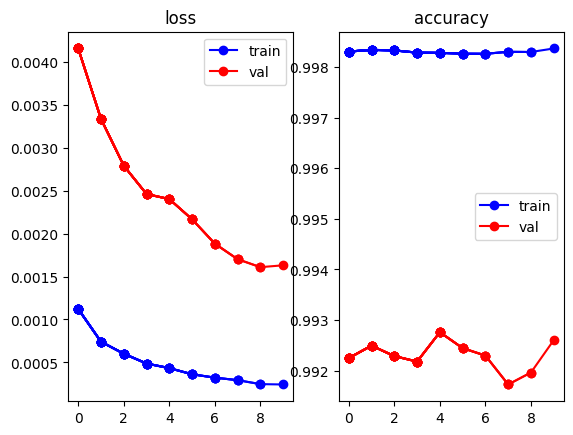

In [141]:
# Train with Tanh function activation, batch size =100 epoch=10 and loss function= MSE  
trainModels(model= model_tanh,name_model='Tanh',trainset=trainNN, validationset=valNN, batch_size=100,epochs=10, sampler=sampler, loss=loss_MSE)  # valores optimos de batch_size y epochs

### Saving trained models

In [72]:
# Run only to save model
def saveModel(path, model): 
    torch.save(model.state_dict(), path) 

# Uncomment to save models
#saveModel(path="./MODELS/Sigmoid/model_Sigmoid.pth", model=model_Sigmoid)
#saveModel(path="./MODELS/ReLU/model_RelU.pth", model=model_Relu)
#saveModel(path="./MODELS/Tanh/model_Tanh1.pth", model=model_tanh)

### Evaluate trained model

In [35]:
# Run to evaluate training 
correct = 0
total = 0
trainset1 = torch.utils.data.DataLoader(trainNN, batch_size=100, shuffle=True)

with torch.no_grad():
    for data in trainset1:
        X, y = data
        output = model_Sigmoid(X.view(-1,104))
        for idx, i in enumerate(output):
            i = torch.round(i)
            if i == y[idx]:
                correct += 1
            total += 1

print("Accuracy: ", round(correct/total, 3))

Accuracy:  0.901


In [36]:
#  Run to evaluate validation
correct = 0
total = 0
valset1 = torch.utils.data.DataLoader(valNN, batch_size=10, shuffle=True)

with torch.no_grad():
    for data in valset1:
        X, y = data
        output = model_Sigmoid(X.view(-1,104))
        for idx, i in enumerate(output):
            i = torch.round(i)
            if i == y[idx]:
                correct += 1
            total += 1

print("Accuracy: ", round(correct/total, 3))

Accuracy:  0.9


In [37]:
#  Run to evaluate test
correct = 0
total = 0
test1 = torch.utils.data.DataLoader(testNN, batch_size=10, shuffle=True)

with torch.no_grad():
    for data in test1:
        X, y = data
        output = model_Sigmoid(X.view(-1,104))
        for idx, i in enumerate(output):
            i = torch.round(i)
            if i == y[idx]:
                correct += 1
            total += 1

print("Accuracy: ", round(correct/total, 3))

Accuracy:  0.901


### Load trained models and weights

In [38]:
#Sigmoid
path = "./MODELS/Sigmoid/model_Sigmoid1.pth" 
model_Sigmoid=model_Sigmoid
model_Sigmoid.load_state_dict(torch.load(path))
model_Sigmoid.eval()
print("Model's state_dict:")
for param_tensor in model_Sigmoid.state_dict():
    print(param_tensor, "\t", model_Sigmoid.state_dict()[param_tensor].size())

Model's state_dict:
layer1.weight 	 torch.Size([120, 104])
layer1.bias 	 torch.Size([120])
layer2.weight 	 torch.Size([1, 120])
layer2.bias 	 torch.Size([1])


In [39]:
# ReLU
path = "./MODELS/ReLU/model_RelU1.pth" 
model_Relu=model_Relu
model_Relu.load_state_dict(torch.load(path))
model_Relu.eval()
print("Model's state_dict:")
for param_tensor in model_Relu.state_dict():
    print(param_tensor, "\t", model_Relu.state_dict()[param_tensor].size())

Model's state_dict:
layer1.weight 	 torch.Size([120, 104])
layer1.bias 	 torch.Size([120])
layer2.weight 	 torch.Size([1, 120])
layer2.bias 	 torch.Size([1])


In [42]:
# Tanh
path = "./MODELS/Tanh/model_Tanh1.pth" 
model_tanh=model_tanh
model_tanh.load_state_dict(torch.load(path))
model_tanh.eval()
print("Model's state_dict:")
for param_tensor in model_tanh.state_dict():
    print(param_tensor, "\t", model_tanh.state_dict()[param_tensor].size())

Model's state_dict:
layer1.weight 	 torch.Size([120, 104])
layer1.bias 	 torch.Size([120])
layer2.weight 	 torch.Size([1, 120])
layer2.bias 	 torch.Size([1])


In [43]:
# Run to define functions for extracting and binarizing weights.

def Binarize(tensor,quant_mode='det'):
    if quant_mode=='det':
        return tensor.sign()
    
def weigths(model):
    if model == 'Sigmoid':
        trained_weights_lay1 = model_Sigmoid.layer1.weight
        trained_weights_lay2 = model_Sigmoid.layer2.weight
        Weight_lay1_Bin=Binarize(trained_weights_lay1)
        Weight_lay2_Bin=Binarize(trained_weights_lay2)
        return Weight_lay1_Bin, Weight_lay2_Bin
    elif model == 'Relu':
        trained_weights_lay1 = model_Relu.layer1.weight
        trained_weights_lay2 = model_Relu.layer2.weight
        Weight_lay1_Bin=Binarize(trained_weights_lay1)
        Weight_lay2_Bin=Binarize(trained_weights_lay2)
        return Weight_lay1_Bin, Weight_lay2_Bin
    elif model == 'Tanh':
        trained_weights_lay1 = model_tanh.layer1.weight
        trained_weights_lay2 = model_tanh.layer2.weight
        Weight_lay1_Bin=Binarize(trained_weights_lay1)
        Weight_lay2_Bin=Binarize(trained_weights_lay2)
        return Weight_lay1_Bin, Weight_lay2_Bin
    
    else: print('No valid model')

In [44]:
# Run to define Binary Neural Network

class BinaryNeuralNetwork(nn.Module):
    
    def __init__(self, Weights_L1, Weights_L2):
        super(BinaryNeuralNetwork, self).__init__()
        #Weights obteined from NN's control plane 
        self.synaptic_weights_lay1 = Weights_L1.T
        self.synaptic_weights_lay2 = Weights_L2.T

    def sign(self, x):
        #applying the sign function
        z= []
        for i in range(len(x)):
            if (x[i] > 0).any() : z.append(1)
            if (x[i] <= 0).any(): z.append(-1)
        return np.array(z)


    def forward(self, inputs):
        #passing the inputs via the neuron to get output   
        results=[]
        for i in inputs:
            print(inputs,i)
            output1 = self.sign(np.dot(i, self.synaptic_weights_lay1))
            output2 = self.sign(np.dot(output1, self.synaptic_weights_lay2))
            results.append(output2)
            
        return torch.Tensor(list(results)) 

In [45]:
# Define weights for Sigmoid Function
L1_sig,L2_sig=weigths('Sigmoid')
binary_sigmoid = BinaryNeuralNetwork(L1_sig,L2_sig)

In [46]:
# Define weights for RelU Function
L1_relu,L2_relu=weigths('Relu')
binary_relu = BinaryNeuralNetwork(L1_relu,L2_relu)

In [47]:
# Define weights for tanh Function
L1_tanh,L2_tanh=weigths('Tanh')
binary_tanh = BinaryNeuralNetwork(L1_tanh,L2_tanh)

In [48]:
#Get all predictions function
def get_all_preds(model, loader):
    all_preds = torch.tensor([])
    all_labels = torch.tensor([])
    c=0
    for batch in loader:
        c=c+1
        if c>=100: break
        data, labels = batch
        preds = model(data.view(-1,104))
        all_preds = torch.cat(
            (all_preds, preds)
            ,dim=0
        )
        all_labels= torch.cat(
            (all_labels,labels)
            ,dim=0
        )
        
    return all_preds, all_labels

### Testing Model Sigmoid

In [49]:
train_batch = torch.utils.data.DataLoader(train_Bin, batch_size=100, shuffle=True)
val_batch = torch.utils.data.DataLoader(val_Bin, batch_size=100, shuffle=True)
test_batch = torch.utils.data.DataLoader(test_Bin, batch_size=100, shuffle=True)

In [50]:
with torch.no_grad():
    prediction_loader = test_batch
    test_preds_Sigmoid, test_labels_Sigmoid = get_all_preds(binary_sigmoid, prediction_loader)

tensor([[ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ..., -1., -1.,  1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ..., -1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.]]) tensor([ 1.,  1.,  1.,  1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,
         1., -1.,  1., -1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1.,  1.,
         1., -1.,  1.,  1., -1., -1.,  1.,  1., -1.,  1.,  1.,  1.,  1.,  1.,
         1., -1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,  1., -1., -1.,
         1., -1., -1.,  1.,  1., -1.,  1.,  1., -1., -1.,  1.,  1., -1.,  1.,
         1.,  1.,  1.,  1.,  1., -1.,  1., -1.,  1., -1.,  1.,  1., -1.,  1.,
         1.,  1.,  1.,  1., -1.,  1.])
tensor([[ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ..., -1.

C:\Users\Informatica\AppData\Local\Temp\ipykernel_13248\3138559311.py:29: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ..\torch\csrc\utils\tensor_new.cpp:248.)
  return torch.Tensor(list(results))


tensor([ 1., -1., -1., -1., -1., -1., -1., -1., -1.,  1., -1.,  1., -1., -1.,
        -1., -1.,  1., -1., -1., -1., -1., -1.,  1., -1., -1., -1., -1., -1.,
         1., -1.,  1., -1.,  1.,  1.,  1., -1.,  1.,  1.,  1., -1.,  1., -1.,
        -1., -1., -1.,  1., -1.,  1., -1.,  1., -1.,  1.,  1., -1., -1., -1.,
         1.,  1., -1.,  1., -1.,  1., -1.,  1., -1., -1.,  1., -1., -1., -1.,
        -1.,  1., -1.,  1., -1.,  1., -1., -1.,  1.,  1.,  1.,  1.,  1., -1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,  1.,  1.,  1.,
         1.,  1., -1.,  1., -1., -1.])
tensor([[ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ..., -1.,  1.,  1.],
        [ 1.,  1.,  1.,  ..., -1.,  1., -1.],
        ...,
        [ 1.,  1.,  1.,  ..., -1.,  1.,  1.],
        [ 1.,  1.,  1.,  ..., -1., -1.,  1.],
        [ 1.,  1.,  1.,  ..., -1., -1.,  1.]]) tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1., -1., -1.,  1.,
        -1., -1.,  1.,  1.,  1.,  1., -1., -1.,

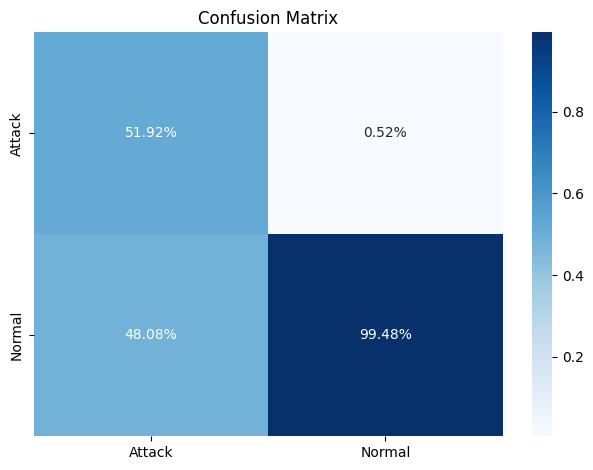

In [51]:
cm_sigmoid = confusion_matrix(test_labels_Sigmoid, test_preds_Sigmoid)
class_names= ['Attack','Normal']
dataframe = pd.DataFrame(cm_sigmoid, index=class_names, columns=class_names)

sns.heatmap(dataframe/np.sum(dataframe), annot=True, 
            fmt='.2%', cmap='Blues')
plt.title("Confusion Matrix"), plt.tight_layout()
plt.show()

In [52]:
metrix_sigmoid= metrics.classification_report(test_labels_Sigmoid, test_preds_Sigmoid)
print(metrix_sigmoid)

              precision    recall  f1-score   support

        -1.0       0.52      1.00      0.68      4357
         1.0       0.99      0.27      0.43      5543

    accuracy                           0.59      9900
   macro avg       0.76      0.64      0.56      9900
weighted avg       0.79      0.59      0.54      9900



### Testing Model Relu

In [53]:
with torch.no_grad():
    prediction_loader = test_batch
    test_preds_relu, test_labels_relu = get_all_preds(binary_relu, prediction_loader)

tensor([[ 1.,  1.,  1.,  ...,  1., -1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ..., -1.,  1., -1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1.,  1., -1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]]) tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1.,
         1., -1.,  1.,  1., -1., -1.,  1., -1., -1.,  1., -1., -1.,  1.,  1.,
        -1.,  1.,  1.,  1.,  1.,  1.,  1., -1.,  1.,  1.,  1., -1., -1., -1.,
         1., -1.,  1., -1.,  1.,  1.,  1., -1.,  1., -1., -1., -1., -1., -1.,
         1.,  1.,  1.,  1.,  1., -1., -1., -1.,  1., -1.,  1.,  1., -1.,  1.,
        -1., -1., -1.,  1., -1.,  1., -1., -1.,  1.,  1.,  1.,  1.,  1., -1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1., -1.,  1., -1., -1.])
tensor([[ 1.,  1.,  1.,  ...,  1., -1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ..., -1.

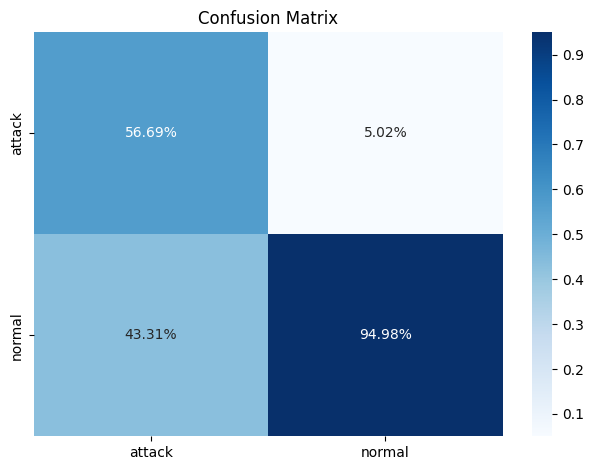

In [54]:
cm_relu = confusion_matrix(test_labels_relu, test_preds_relu)
class_names= ['attack','normal']
dataframe = pd.DataFrame(cm_relu, index=class_names, columns=class_names)


sns.heatmap(dataframe/np.sum(dataframe), annot=True, 
            fmt='.2%', cmap='Blues')
plt.title("Confusion Matrix"), plt.tight_layout()
plt.show()

In [55]:
metrix_relu= metrics.classification_report(test_labels_relu, test_preds_relu)
print(metrix_relu)

              precision    recall  f1-score   support

        -1.0       0.57      0.97      0.72      4347
         1.0       0.95      0.42      0.58      5553

    accuracy                           0.66      9900
   macro avg       0.76      0.70      0.65      9900
weighted avg       0.78      0.66      0.64      9900



### Testing Model Tanh

In [56]:
with torch.no_grad():
    prediction_loader = test_batch
    test_preds_tanh, test_labels_tanh = get_all_preds(binary_tanh, prediction_loader)

tensor([[ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1., -1.],
        [ 1.,  1.,  1.,  ...,  1., -1., -1.],
        ...,
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1.,  1.],
        [ 1.,  1.,  1.,  ..., -1., -1.,  1.]]) tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1., -1., -1.,  1.,
        -1., -1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1., -1.,  1., -1.,
        -1., -1., -1., -1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1., -1.,  1.,
        -1., -1., -1.,  1.,  1.,  1., -1.,  1., -1.,  1., -1., -1.,  1., -1.,
        -1., -1.,  1., -1., -1.,  1.,  1., -1.,  1.,  1., -1.,  1., -1.,  1.,
         1.,  1., -1.,  1.,  1., -1.,  1.,  1., -1., -1.,  1.,  1., -1.,  1.,
         1.,  1.,  1.,  1.,  1., -1.,  1., -1.,  1., -1.,  1.,  1., -1.,  1.,
        -1.,  1.,  1.,  1.,  1.,  1.])
tensor([[ 1.,  1.,  1.,  ...,  1.,  1.,  1.],
        [ 1.,  1.,  1.,  ...,  1., -1., -1.],
        [ 1.,  1.,  1.,  ...,  1.

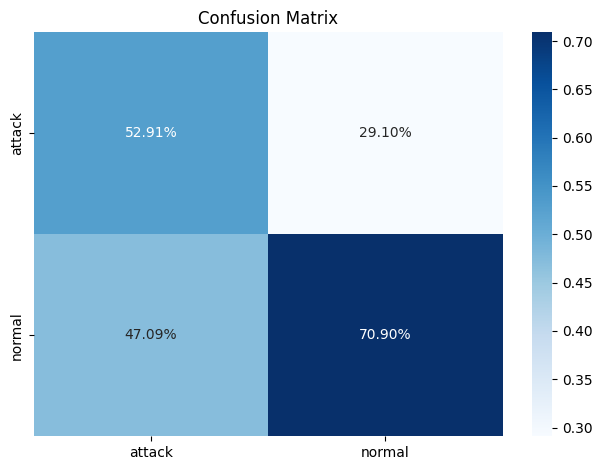

In [57]:
cm_tanh = confusion_matrix(test_labels_tanh, test_preds_tanh)
class_names= ['attack','normal']
dataframe = pd.DataFrame(cm_tanh, index=class_names, columns=class_names)

sns.heatmap(dataframe/np.sum(dataframe), annot=True, 
            fmt='.2%', cmap='Blues')
plt.title("Confusion Matrix"), plt.tight_layout()
plt.show()

In [58]:
metrix_tanh= metrics.classification_report(test_labels_tanh, test_preds_tanh)
print(metrix_tanh)

              precision    recall  f1-score   support

        -1.0       0.53      0.76      0.62      4376
         1.0       0.71      0.46      0.56      5524

    accuracy                           0.59      9900
   macro avg       0.62      0.61      0.59      9900
weighted avg       0.63      0.59      0.59      9900

